In [3]:
%cd C:/Users/wangj337/Google Drive/Courses/IntroAI-CS50/5NeuralNetwork/src5/banknotes

C:\Users\wangj337\Google Drive\Courses\IntroAI-CS50\5NeuralNetwork\src5\banknotes


In [4]:
# %load banknotes.py
import csv
import tensorflow as tf

from sklearn.model_selection import train_test_split

# Read data in from file
with open("banknotes.csv") as f:
    reader = csv.reader(f)
    next(reader)

    data = []
    for row in reader:
        data.append({
            "evidence": [float(cell) for cell in row[:4]],
            "label": 1 if row[4] == "0" else 0
        })

# Separate data into training and testing groups
evidence = [row["evidence"] for row in data]
labels = [row["label"] for row in data]
X_training, X_testing, y_training, y_testing = train_test_split(
    evidence, labels, test_size=0.4
)

# Create a neural network
model = tf.keras.models.Sequential()

# Add a hidden layer with 8 units, with ReLU activation
model.add(tf.keras.layers.Dense(8, input_shape=(4,), activation="relu"))

# Add output layer with 1 unit, with sigmoid activation
model.add(tf.keras.layers.Dense(1, activation="sigmoid"))

# Train neural network
model.compile(
    optimizer="adam",
    loss="binary_crossentropy", # used to optimize your model (which will be minimized by the optimizer)
    metrics=["accuracy"] # used to judge the performance (for human ti look at and has nothing to do with the optimization process)
)
# Binary entropy = -ylog(1 - p) - (1 - y)log(p), operates on the estimated probability, continuous
# Accuracy = (\sumI(p==y)) / n, discrete, can fluctuate

model.fit(X_training, y_training, epochs=20)
# ADAM: https://arxiv.org/pdf/1412.6980.pdf?source=post_page---------------------------

# Evaluate how well model performs
model.evaluate(X_testing, y_testing, verbose=2)


INFO:tensorflow:Enabling eager execution
INFO:tensorflow:Enabling v2 tensorshape
INFO:tensorflow:Enabling resource variables
INFO:tensorflow:Enabling tensor equality
INFO:tensorflow:Enabling control flow v2
Epoch 1/20
26/26 [==============================] - 1s 718us/step - loss: 0.7840 - accuracy: 0.5650
Epoch 2/20
26/26 [==============================] - 0s 718us/step - loss: 0.7189 - accuracy: 0.6148
Epoch 3/20
26/26 [==============================] - 0s 838us/step - loss: 0.6567 - accuracy: 0.6707
Epoch 4/20
26/26 [==============================] - 0s 758us/step - loss: 0.5987 - accuracy: 0.7108
Epoch 5/20
26/26 [==============================] - 0s 758us/step - loss: 0.5424 - accuracy: 0.7388
Epoch 6/20
26/26 [==============================] - 0s 919us/step - loss: 0.4909 - accuracy: 0.7594
Epoch 7/20
26/26 [==============================] - 0s 918us/step - loss: 0.4440 - accuracy: 0.7776
Epoch 8/20
26/26 [==============================] - 0s 878us/step - loss: 0.4025 - accuracy: 

[0.16984151303768158, 0.9763205647468567]

In [12]:
# %load handwriting.py
import sys
import tensorflow as tf

# Use MNIST handwriting dataset
mnist = tf.keras.datasets.mnist

# Prepare data for training
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0
y_train = tf.keras.utils.to_categorical(y_train)
y_test = tf.keras.utils.to_categorical(y_test)
x_train = x_train.reshape(
    x_train.shape[0], x_train.shape[1], x_train.shape[2], 1
)
x_test = x_test.reshape(
    x_test.shape[0], x_test.shape[1], x_test.shape[2], 1
)

# Create a convolutional neural network
model = tf.keras.models.Sequential([

    # Convolutional layer. Learn 32 filters using a 3x3 kernel
    tf.keras.layers.Conv2D(
        32, (3, 3), activation="relu", input_shape=(28, 28, 1)
        # filter = 32, kernel size = (3, 3)
        # filters: Integer, the dimensionality of the output space (i.e. the number of output filters in the convolution).
        # kernel_size : An integer or tuple/list of 2 integers, specifying the height and width of the 2D convolution window. Can be a single integer to specify the same value for all spatial dimensions.
    ),

    # Max-pooling layer, using 2x2 pool size
    tf.keras.layers.MaxPooling2D(pool_size=(2, 2)),

    # Flatten units
    tf.keras.layers.Flatten(),

    # Add a hidden layer with dropout
    tf.keras.layers.Dense(128, activation="relu"),
    tf.keras.layers.Dropout(0.5),

    # Add an output layer with output units for all 10 digits
    tf.keras.layers.Dense(10, activation="softmax")
])

# Train neural network
model.compile(
    optimizer="adam",
    loss="categorical_crossentropy",
    metrics=["accuracy"]
)
model.fit(x_train, y_train, epochs=10)

# Evaluate neural network performance
model.evaluate(x_test,  y_test, verbose=2)

# Save model to file
if len(sys.argv) == 2:
    filename = sys.argv[1]
    model.save(filename)
    print(f"Model saved to {filename}.")


Epoch 1/10
1875/1875 [==============================] - 45s 24ms/step - loss: 0.2595 - accuracy: 0.9224
Epoch 2/10
1875/1875 [==============================] - 44s 23ms/step - loss: 0.1085 - accuracy: 0.9682
Epoch 3/10
1875/1875 [==============================] - 43s 23ms/step - loss: 0.0845 - accuracy: 0.9746
Epoch 4/10
1875/1875 [==============================] - 43s 23ms/step - loss: 0.0692 - accuracy: 0.9790
Epoch 5/10
1875/1875 [==============================] - 42s 22ms/step - loss: 0.0587 - accuracy: 0.9821
Epoch 6/10
1875/1875 [==============================] - 42s 22ms/step - loss: 0.0504 - accuracy: 0.9850
Epoch 7/10
1875/1875 [==============================] - 42s 22ms/step - loss: 0.0447 - accuracy: 0.9853
Epoch 8/10
1875/1875 [==============================] - 44s 23ms/step - loss: 0.0378 - accuracy: 0.9877
Epoch 9/10
1875/1875 [==============================] - 42s 23ms/step - loss: 0.0356 - accuracy: 0.9880
Epoch 10/10
1875/1875 [==============================] - 42s 22m

In [8]:
(x_train, y_train), (x_test, y_test) = mnist.load_data()
x_train, x_test = x_train / 255.0, x_test / 255.0
y_test[0:9]

array([7, 2, 1, 0, 4, 1, 4, 9, 5], dtype=uint8)

In [9]:
y_train = tf.keras.utils.to_categorical(y_train)
y_test = tf.keras.utils.to_categorical(y_test)
y_test[0:9]

array([[0., 0., 0., 0., 0., 0., 0., 1., 0., 0.],
       [0., 0., 1., 0., 0., 0., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0., 0., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1., 0., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1., 0., 0., 0., 0., 0.],
       [0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
       [0., 0., 0., 0., 0., 1., 0., 0., 0., 0.]], dtype=float32)

In [10]:
filename = "mnist_example"
model.save(filename)

INFO:tensorflow:Assets written to: mnist_example\assets


In [20]:
res = model.predict(x_train[0].reshape(1, 28, 28, 1))
res

array([[4.3837296e-16, 6.5426919e-14, 5.9526622e-16, 6.2463645e-02,
        2.5611153e-17, 9.3753612e-01, 3.2423940e-12, 1.6999665e-14,
        1.6058900e-10, 1.8387486e-07]], dtype=float32)

In [27]:
import numpy as np
print(np.amax(res))
print(res.argmax())
print(y_train[0])

0.9375361
5
[0. 0. 0. 0. 0. 1. 0. 0. 0. 0.]


In [11]:
# example of calculation 2d convolutions
from numpy import asarray
from keras.models import Sequential
from keras.layers import Conv2D
# define input data
data = [[0, 0, 0, 1, 1, 0, 0, 0],
		[0, 0, 0, 1, 1, 0, 0, 0],
		[0, 0, 0, 1, 1, 0, 0, 0],
		[0, 0, 0, 1, 1, 0, 0, 0],
		[0, 0, 0, 1, 1, 0, 0, 0],
		[0, 0, 0, 1, 1, 0, 0, 0],
		[0, 0, 0, 1, 1, 0, 0, 0],
		[0, 0, 0, 1, 1, 0, 0, 0]]
data = asarray(data)
data = data.reshape(1, 8, 8, 1)
# create model
model1 = Sequential()
model1.add(Conv2D(1, (3,3), input_shape=(8, 8, 1)))
# define a vertical line detector
detector = [[[[0]],[[1]],[[0]]],
            [[[0]],[[1]],[[0]]],
            [[[0]],[[1]],[[0]]]]
weights = [asarray(detector), asarray([0.0])]
# store the weights in the model
model1.set_weights(weights)
# confirm they were stored
print(model1.get_weights())
# apply filter to input data
yhat = model1.predict(data)
for r in range(yhat.shape[1]):
	# print each column in the row
	print([yhat[0,r,c,0] for c in range(yhat.shape[2])])

[array([[[[0.]],

        [[1.]],

        [[0.]]],


       [[[0.]],

        [[1.]],

        [[0.]]],


       [[[0.]],

        [[1.]],

        [[0.]]]], dtype=float32), array([0.], dtype=float32)]
[0.0, 0.0, 3.0, 3.0, 0.0, 0.0]
[0.0, 0.0, 3.0, 3.0, 0.0, 0.0]
[0.0, 0.0, 3.0, 3.0, 0.0, 0.0]
[0.0, 0.0, 3.0, 3.0, 0.0, 0.0]
[0.0, 0.0, 3.0, 3.0, 0.0, 0.0]
[0.0, 0.0, 3.0, 3.0, 0.0, 0.0]


In [1]:
%cd C:/Users/wangj337/Google Drive/Courses/IntroAI-CS50/5NeuralNetwork/src5/digits
%run recognition.py "mnist_example"

C:\Users\wangj337\Google Drive\Courses\IntroAI-CS50\5NeuralNetwork\src5\digits
pygame 2.0.1 (SDL 2.0.14, Python 3.9.2)
Hello from the pygame community. https://www.pygame.org/contribute.html
INFO:tensorflow:Enabling eager execution
INFO:tensorflow:Enabling v2 tensorshape
INFO:tensorflow:Enabling resource variables
INFO:tensorflow:Enabling tensor equality
INFO:tensorflow:Enabling control flow v2
[[2.0162018e-11 1.4701265e-12 9.9999952e-01 1.5356166e-07 5.3802680e-16
  6.1387493e-14 1.9981629e-18 2.6814521e-07 5.8132821e-10 2.8082735e-14]]
[[5.0075282e-03 5.3601847e-03 8.2815051e-01 1.4111578e-01 2.6921697e-03
  1.2207388e-06 9.6317483e-03 2.3149992e-03 5.1437756e-03 5.8211148e-04]]
[[5.0075282e-03 5.3601847e-03 8.2815051e-01 1.4111578e-01 2.6921697e-03
  1.2207388e-06 9.6317483e-03 2.3149992e-03 5.1437756e-03 5.8211148e-04]]
[[1.4012012e-15 1.3680021e-10 6.1871081e-15 3.7487074e-15 3.5456618e-10
  4.9610828e-14 4.0408215e-19 1.0000000e+00 3.2503199e-14 3.7539638e-09]]
[[1.4012012e-15 1.

In [8]:
# %load filter.py
import math
import sys

from PIL import Image, ImageFilter

# Ensure correct usage
#if len(sys.argv) != 2:
#    sys.exit("Usage: python filter.py filename")

# Open image
#image = Image.open(sys.argv[1]).convert("RGB")
image = Image.open("cookies.JPG").convert("RGB")

# Filter image according to edge detection kernel
filtered = image.filter(ImageFilter.Kernel(
    size=(3, 3),
    kernel=[-1, -1, -1, -1, 8, -1, -1, -1, -1],
    scale=1
))

# Show resulting image
#filtered.show()


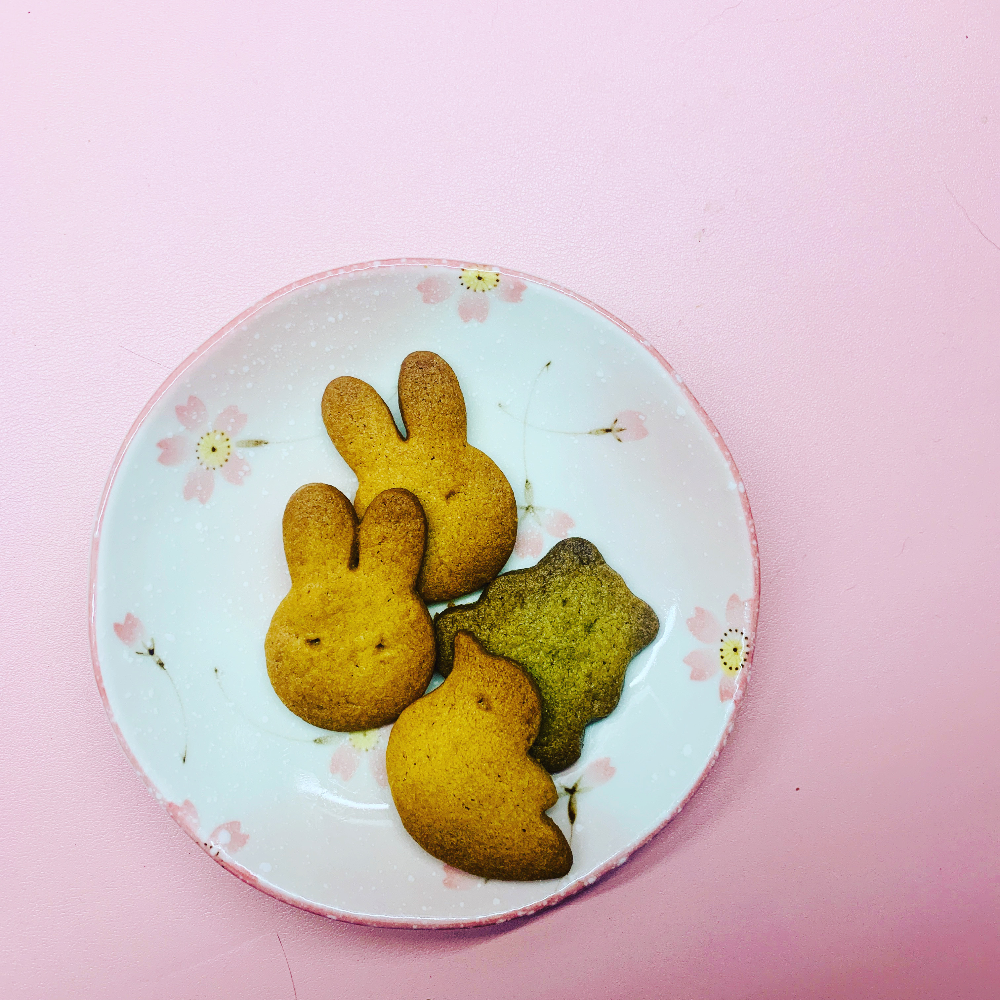

In [9]:
image

In [5]:
type(image)

PIL.Image.Image

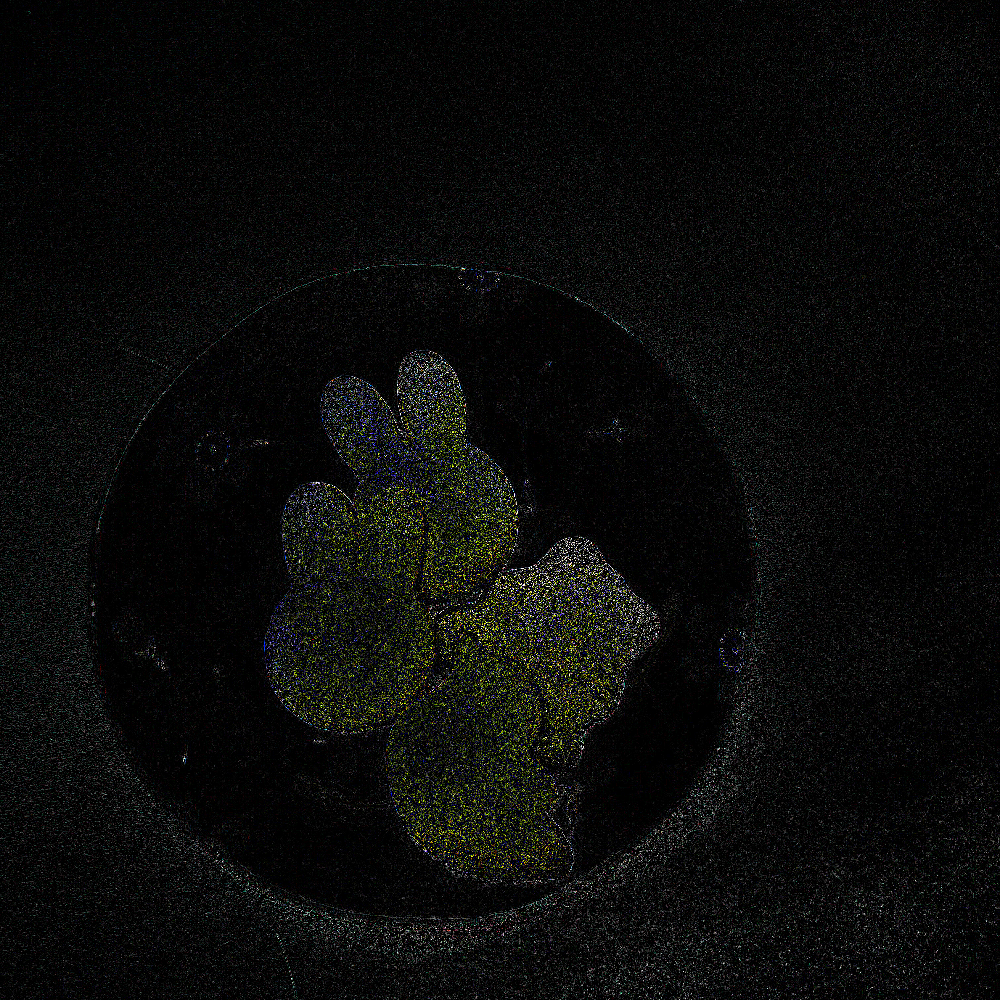

In [11]:
filtered